In [2]:
import plotly.graph_objs as go
import math
from scipy.stats import chi2
from matplotlib.patches import Ellipse
from IPython.display import display, clear_output
from numpy.linalg import eigh
import megaman
from megaman.geometry import Geometry
from megaman.embedding import (Isomap, LocallyLinearEmbedding, LTSA, SpectralEmbedding)
import sklearn
from sklearn.manifold import TSNE
import numpy as np
import matplotlib.pyplot as plt
import umap
from megaman.geometry.rmetric import RiemannMetric
from megaman.utils.covar_plotter import plot_cov_ellipse
%matplotlib inline

In [3]:
# basic plotting setting, coloring direction:
name="_"+"vert"
large_dot=True
large_dot_name="_largedot" if large_dot else ""
dot_size=5 if large_dot else 1
output_dir='manifold-learning-examples/graphs-from-ARSIA-figs/'


In [4]:

# plot embedding and rmetric
from scipy.spatial import distance_matrix
class PlotResult():
    def __init__(self,embedding_method,data,dataname,dimension,radius,output_dir=output_dir):
        self.embedding_method = embedding_method
        self.data = data
        self.d = dimension
        self.embedded_data = np.zeros(data.shape)
        self.H = np.zeros((data.shape[0],dimension,dimension))
        self.filename = output_dir + dataname + embedding_method
        self.radius=radius
        self.figures={}
        
    def compute_geom(self):
        data = self.data
        d = self.d
        adjacency_method = 'cyflann'
        adjacency_kwds = {'radius':self.radius} # ignore distances above this radius
        affinity_method = 'gaussian'
        affinity_kwds = {'radius':self.radius} # A = exp(-||x - y||/radius^2)
        laplacian_method = 'geometric'
        laplacian_kwds = {'scaling_epps':self.radius} # scaling ensures convergence to Laplace-Beltrami operator

        geom  = Geometry(adjacency_method=adjacency_method, adjacency_kwds=adjacency_kwds,
                 affinity_method=affinity_method, affinity_kwds=affinity_kwds,
                 laplacian_method=laplacian_method, laplacian_kwds=laplacian_kwds)
        geom.set_data_matrix(data)
        laplacian_matrix = geom.compute_laplacian_matrix()
        
        if self.embedding_method == 'Isomap':
            isomap = Isomap(n_components=d, eigen_solver='arpack', geom=geom)
            self.embedded_data = isomap.fit_transform(data)
            # rmetric = RiemannMetric(self.embedded_data, geom.laplacian_matrix)
            # self.H = rmetric.get_dual_rmetric()
        
        elif self.embedding_method == 'LE':
            spectral = SpectralEmbedding(n_components=d, eigen_solver='arpack',geom=geom)
            self.embedded_data = spectral.fit_transform(data)
            
        elif self.embedding_method == 'LTSA':
            ltsa = LTSA(n_components=d, eigen_solver='dense',geom=geom)
            self.embedded_data = ltsa.fit_transform(data)
            
        elif self.embedding_method == 'LLE':
            lle = LocallyLinearEmbedding(n_components=d, eigen_solver='arpack', geom=geom)
            self.embedded_data = lle.fit_transform(data)
            
        elif self.embedding_method == 't-SNE':
            tsne = TSNE(n_components=2, init='pca', random_state=0)
            self.embedded_data = tsne.fit_transform(data)
            
        elif self.embedding_method == 'Umap':
            reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, metric='euclidean')
            self.embedded_data = reducer.fit_transform(data)
            
        else:
            print('No such method!')
            return 
        
        rmetric = RiemannMetric(self.embedded_data, geom.laplacian_matrix)
        self.H = rmetric.get_dual_rmetric()

        self.e_values = np.linalg.eigvals(self.H)
        self.kappa = np.max(self.e_values,axis=1)/np.min(self.e_values,axis=1)
        kappa_median = np.median(self.kappa)
        self.kappa = [min(kappa_median+1000, max(0, i)) for i in self.kappa]

    
    def plot_result(self,n_plot,rellip,seed,point_size=dot_size,point_color='blue'):
        rng = np.random.RandomState(seed)
        sample_points = rng.choice(range(self.data.shape[0]), n_plot, replace = False)       
        #if self.embedding_method in set(['LLE','LE','LTSA','Isomap']) and plot_rmetric:
        f1, ax = plt.subplots(figsize=(8,8))
        ax.scatter(self.embedded_data[:, 0], self.embedded_data[:, 1], s = point_size,c=point_color)
        ax.set_axis_off()
        f1.tight_layout()
        self.figures['_no_metric'] = f1
        f2, ax = plt.subplots(figsize=(8,8))
        ax.scatter(self.embedded_data[:, 0], self.embedded_data[:, 1], s = point_size,c=point_color)
        ax.set_aspect('equal') # if an ellipse is a circle no distortion occured. 
        for i in range(n_plot):
            ii = sample_points[i]
            cov = self.H[ii, :, :]
            plot_cov_ellipse(cov*rellip, self.embedded_data[ii, :] ,ax=ax, edgecolor='none', alpha = 0.5)
        ax.set_axis_off()
        f1.tight_layout()
        self.figures['_with_metric'] = f2

    %matplotlib widget
    def interactive_plot(self, rellip, point_size, point_color='blue'):
        fig, ax = plt.subplots(figsize=(8,8))
        scatter = ax.scatter(self.embedded_data[:, 0], self.embedded_data[:, 1], s=point_size, c=point_color, picker=True)

        self.ellip_artist = None

        def on_hover(event):
            cont, ind = scatter.contains(event)
            if cont:
                ax.figure.canvas.draw_idle()  # Make sure the canvas is ready for update
                if self.ellip_artist:
                    self.ellip_artist.remove()  # Remove the previous ellipse if it exists
                picked_index = ind["ind"][0]  # Get the index of the hovered point
                cov = self.H[picked_index, :, :]
                pos = self.embedded_data[picked_index, :]
                self.ellip_artist = plot_cov_ellipse(cov * rellip, pos, ax=ax, edgecolor='lightblue', alpha=0.5, linewidth=1)
                ax.figure.canvas.draw_idle()  # Redraw with the new ellipse

        fig.canvas.mpl_connect('motion_notify_event', on_hover)
        ax.set_axis_off()
        fig.tight_layout()
        plt.show()

    def plot_radius(self, cropped_indices ,samples,rellip,point_size=dot_size,point_color='blue'):
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.scatter(self.embedded_data[cropped_indices, 0], self.embedded_data[cropped_indices, 1], s = point_size,c=point_color)
        ax.set_aspect('equal')
        for i in samples:
            cov = self.H[i, :, :]
            plot_cov_ellipse(cov*rellip, self.embedded_data[i, :] ,ax=ax, edgecolor='red', alpha = 0.5)
        ax.set_axis_off()
        fig.tight_layout()
        plt.show()

    def plot_3d(self,point_size=dot_size,point_color='blue'):
        fig, ax = plt.subplots(subplot_kw={'projection': '3d'},figsize=(8,8))

        # Scatter plot
        sc = ax.scatter(self.data[:,1], self.data[:,3], self.data[:,5], s=point_size, c=point_color, cmap='viridis')

        # Adding color bar
        cbar = plt.colorbar(sc)
        cbar.set_label('Color Scale')

        # Setting labels
        ax.set_xlabel('1-evec')
        ax.set_ylabel('3-evec')
        ax.set_zlabel('5-evec')
        # Showing the plot
        plt.show()
        

    def save_figure(self,font,dpi=3000):
        for key,fig in self.figures.items():
            fig.savefig(self.filename+key+name+large_dot_name+'.'+font, dpi=dpi)
            
            

In [5]:
def helper_plot_radius( x, y, z, indices, cut_degree=45):
    angle_rad = math.radians(cut_degree)
    y_pos_cut = np.tan(angle_rad) * x
    y_neg_cut = -np.tan(angle_rad) * x
    cropped_index = (y >= y_neg_cut) & (y <= y_pos_cut)
    evenly_spaced_z = np.linspace(np.min(z), np.max(z), 10)

    closest_indices = []
    for target_z in evenly_spaced_z:
        if len(indices) > 0:  # Ensure there are points in the subset
            distances = np.abs(z[indices] - target_z)
            min_dist_index = np.argmin(distances)
            closest_indices.append(indices[min_dist_index])
        else:
            closest_indices.append(None) 
    return cropped_index, closest_indices

In [5]:
# data = np.random.uniform(size=200).reshape((100,2))
# exp_isomap = PlotResult(embedding_method='Isomap',data=data,dataname='test_',dimension=2,radius=0.5,output_dir=output_dir)
# exp_isomap.compute_geom()
# exp_isomap.plot_result(20,0.0025,2014012168)
# exp_isomap.figures
# exp_isomap.save_figure(font='svg')

# Swiss Roll with a hole (d=50)
The first example is a 100 * 6 swiss roll with a hole rotated in R^50. 

In [6]:
# Generate swiss roll
from scipy.stats import special_ortho_group
def get_swiss_roll_data(n = 10000, theta =np.pi / 4,xvar = 0., rotate = True, b = 49):

    ts = .75 * np.pi * (1 + 2 * np.random.uniform(low=0.0, high=1.0, size=n)) + 15
    x = ts * np.cos(ts)
    y = 101 * np.random.uniform(low=0.0, high=1.0, size=n)
    #self.ys = y
    z = ts * np.sin(ts)
    
    filter_array = np.array([(ts[i] < 15+np.pi*1.75) and (ts[i] > np.pi*1.25+15) and (y[i] < 75) and (y[i] > 25) for i in range(n)])
    #self.ts = ts
    X = np.vstack((x, y, z))
    X = X.T
    X = X[~filter_array]
    ts=ts[~filter_array]
    y=y[~filter_array]
    z = z[~filter_array]
    unrotated_data = np.zeros((X.shape[0], b))
    unrotated_data[:, :3] = X


    if rotate:
        rotator = special_ortho_group.rvs(b)
        data = np.matmul(unrotated_data, rotator)
    else:
        rotator = np.identity(b)
        data = unrotated_data

    if xvar != 0.:
        data += np.random.multivariate_normal(np.zeros(b), np.identity(b) * xvar, n)

    return(data,rotator, ts, y,z)


In [9]:
n_components = 2
b = 49
d = 2
data,rotator, x,y,z = get_swiss_roll_data(n=10000,theta=np.pi/4,xvar = 0.,rotate = True, b=b)
import pickle
pickle.dump(data, open('sr_data.pickle','wb'))
indices = np.where(( 0<= y) & (y <=0.1) & (x>0))[0]
cropped_index, closest_indices = helper_plot_radius(x, y, z, indices, cut_degree=45)

In [10]:
radius = 1.88
n_neighbors = 100
sr_isomap =  PlotResult(embedding_method='Isomap',data=data,dataname='sr_',dimension=n_components,radius=radius,output_dir=output_dir)
sr_isomap.compute_geom()

In [11]:
radius = 1.88
n_neighbors = 100
data = pickle.load(open('sr_data.pickle','rb'))
sr_LE = PlotResult(embedding_method = 'LE',data=data,dataname='sr_',dimension=2,radius=radius,output_dir=output_dir)
sr_LE.compute_geom()



In [13]:
radius = 2.5
n_neighbors = 100
sr_LTSA = PlotResult(embedding_method = 'LTSA',data=data,dataname='sr_',dimension=2,radius=radius,output_dir=output_dir)
sr_LTSA.compute_geom()

In [14]:
sr_LLE = PlotResult(embedding_method = 'LLE',data=data,dataname='sr_',dimension=2,radius=radius,output_dir=output_dir)
sr_LLE.compute_geom()

In [15]:
# import pickle
# data = pickle.load(open('sr_data.pickle','rb'))
sr_umap = PlotResult(embedding_method = 'Umap',data=data,dataname='sr_',dimension=2,radius=1.88,output_dir=output_dir)
sr_umap.compute_geom()

In [16]:
sr_tsne = PlotResult(embedding_method = 't-SNE',data=data,dataname='sr_',dimension=2,radius=radius,output_dir=output_dir)
sr_tsne.compute_geom()

In [17]:
direction=y if name=="_horiz" else z

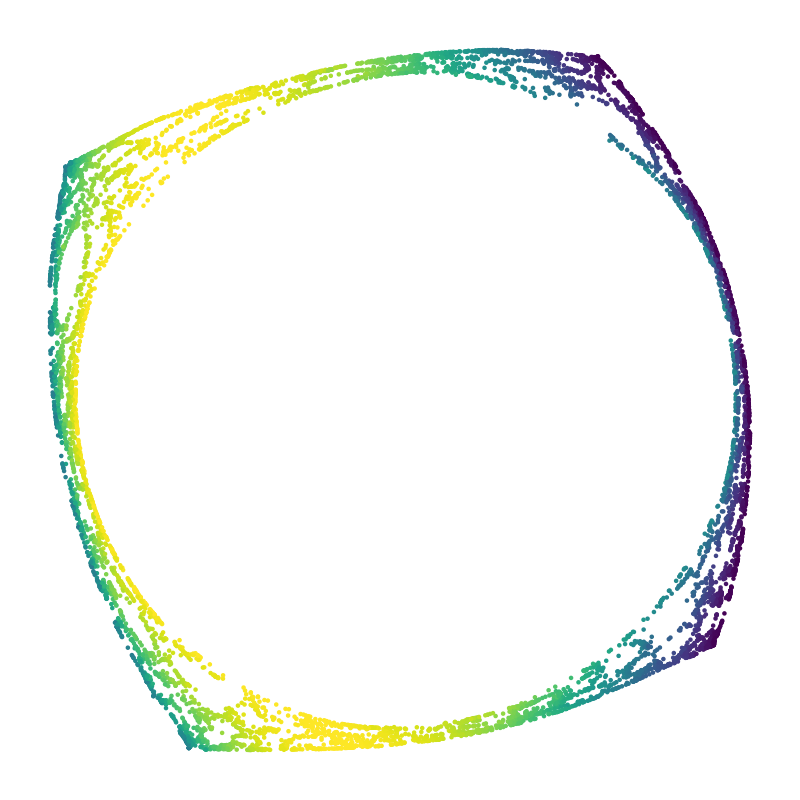

In [18]:
sr_LE.interactive_plot(0.15,point_color=direction,point_size=dot_size)

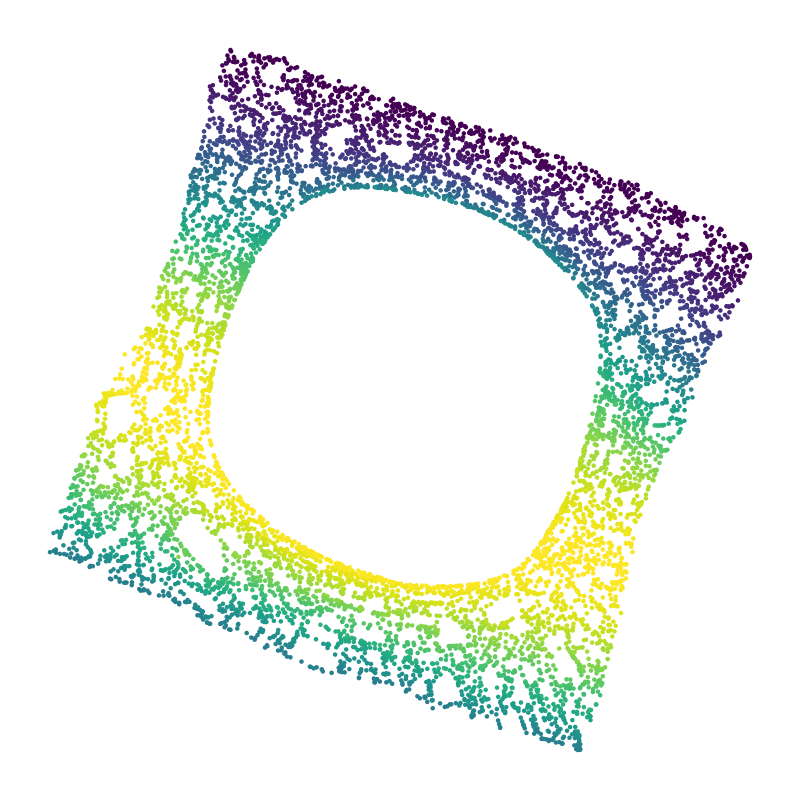

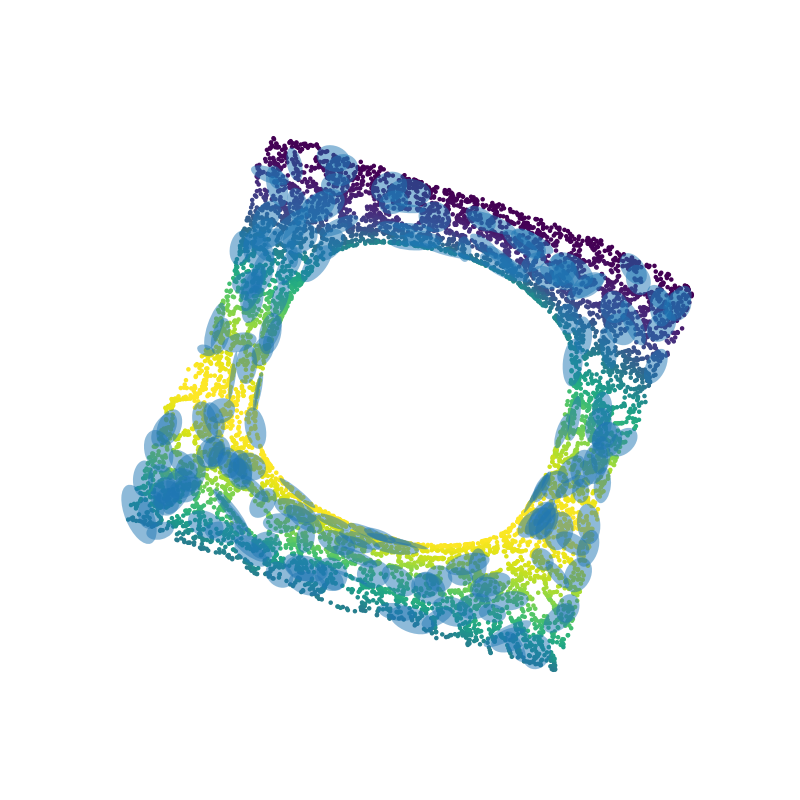

In [19]:
sr_isomap.plot_result(200,10,2014012168,point_color=direction,point_size=dot_size)

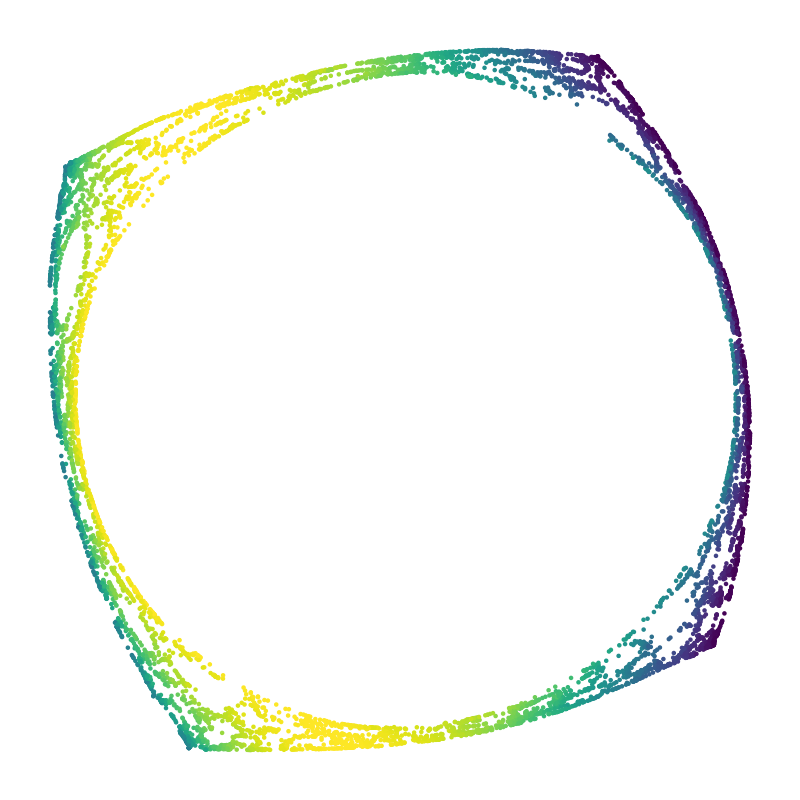

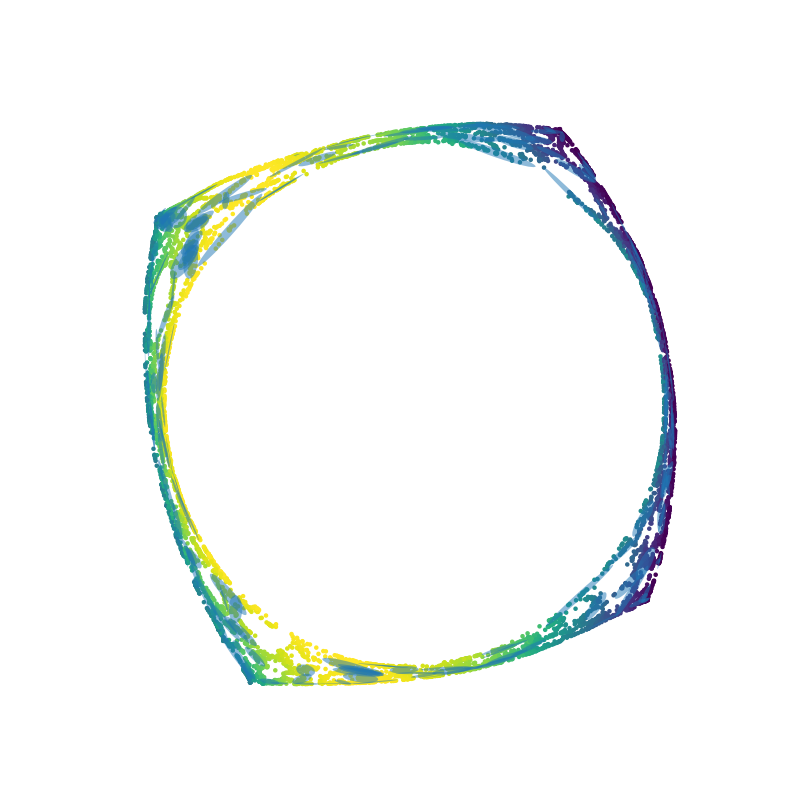

In [20]:
sr_LE.plot_result(200,10,2014012168,point_color=direction,point_size=dot_size)

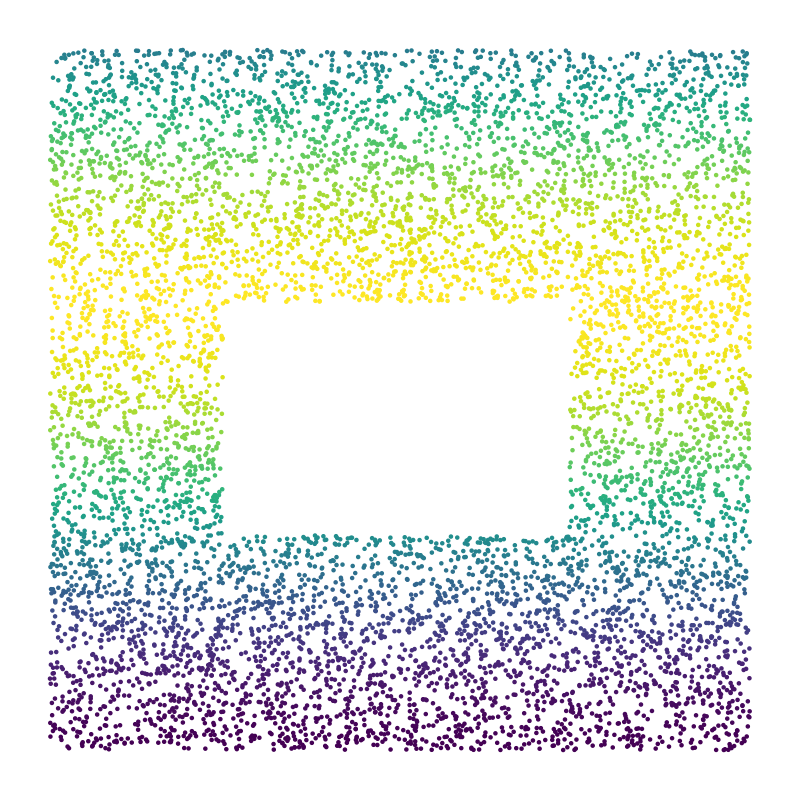

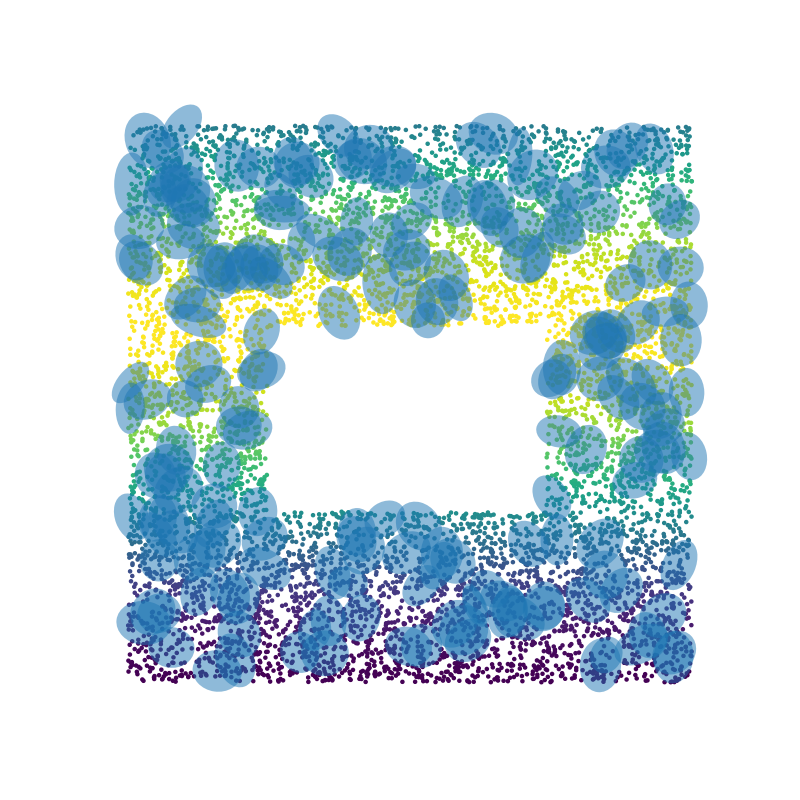

In [21]:
sr_LTSA.plot_result(200,10,2014012168,point_color=direction,point_size=dot_size)

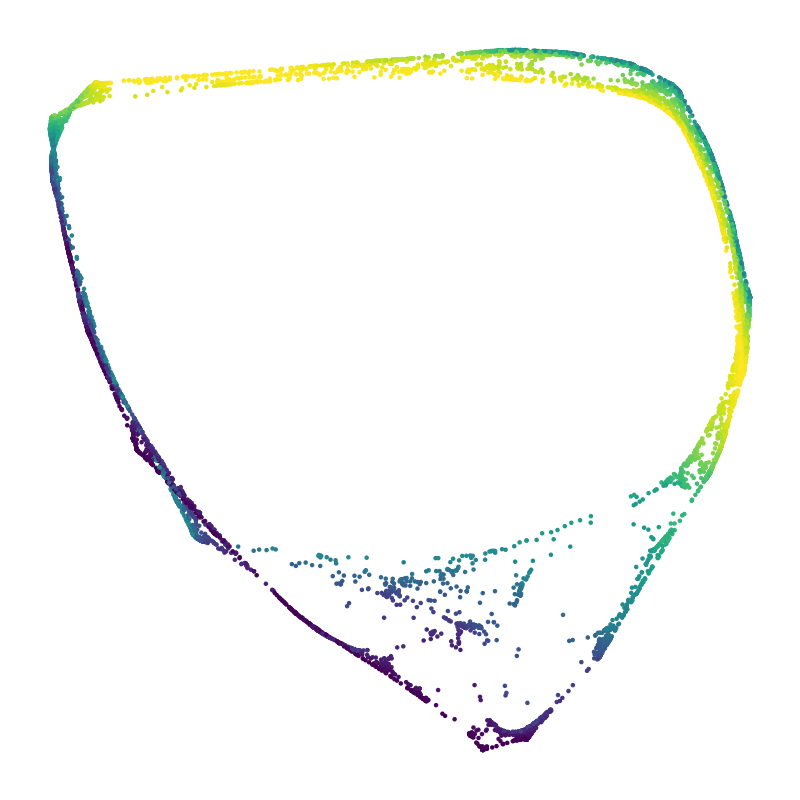

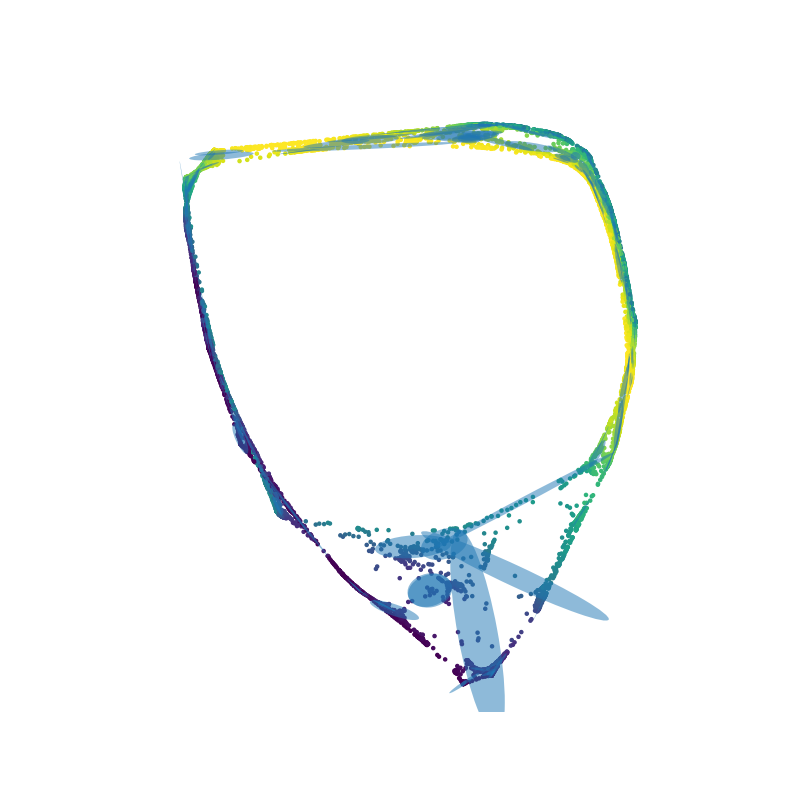

In [22]:
sr_LLE.plot_result(200,10,2014012168,point_color=direction,point_size=dot_size)

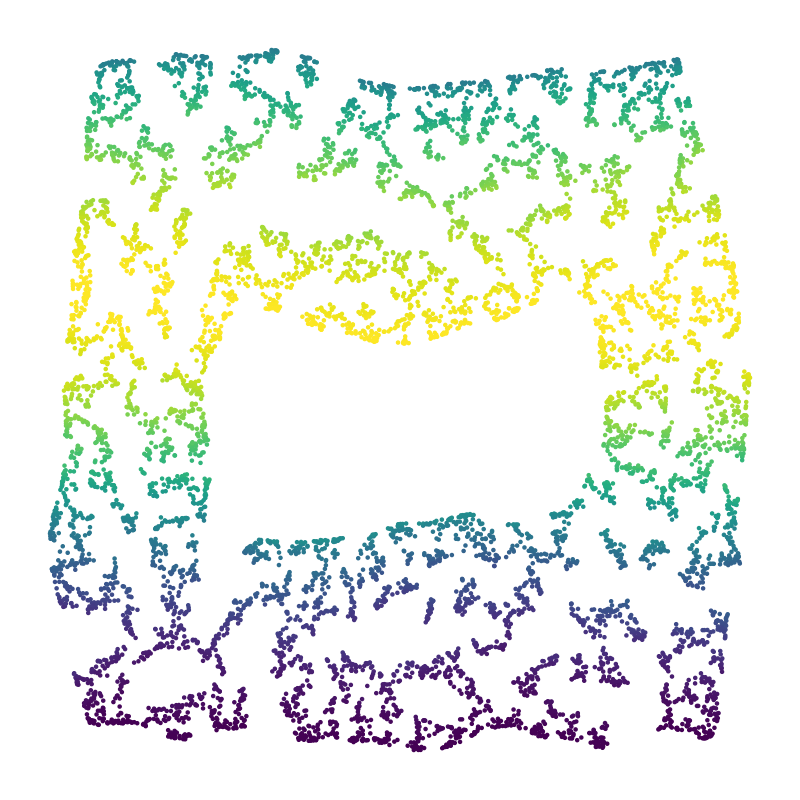

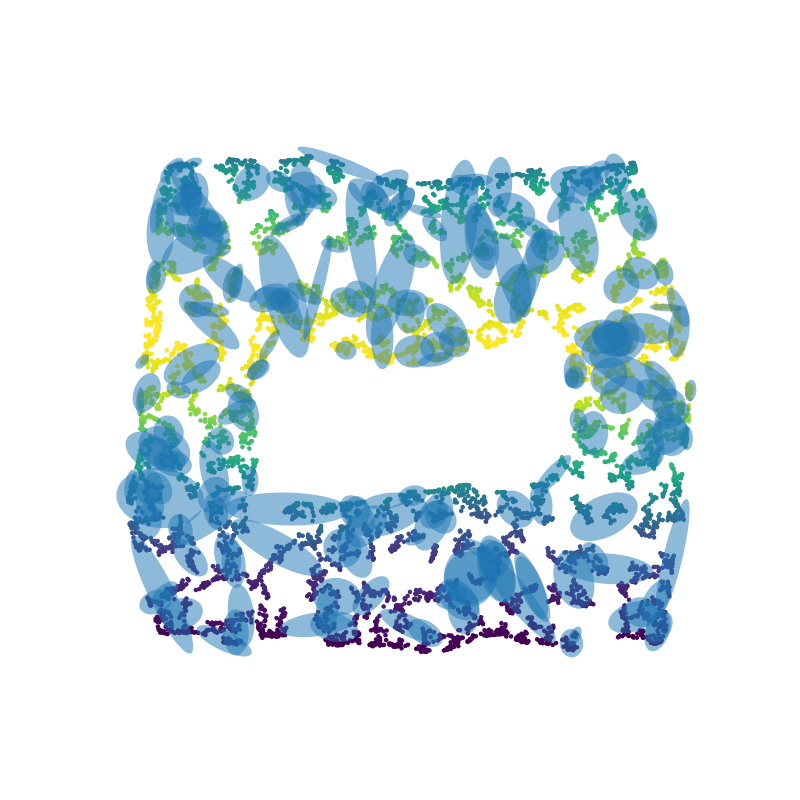

In [23]:
sr_tsne.plot_result(200,10,2014012168,point_color=direction,point_size=dot_size)

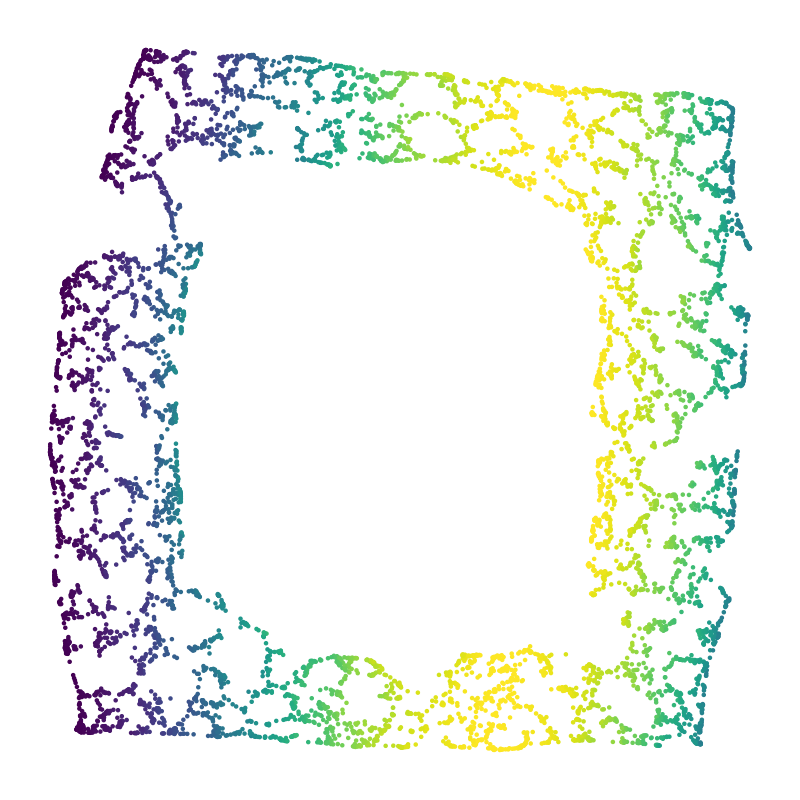

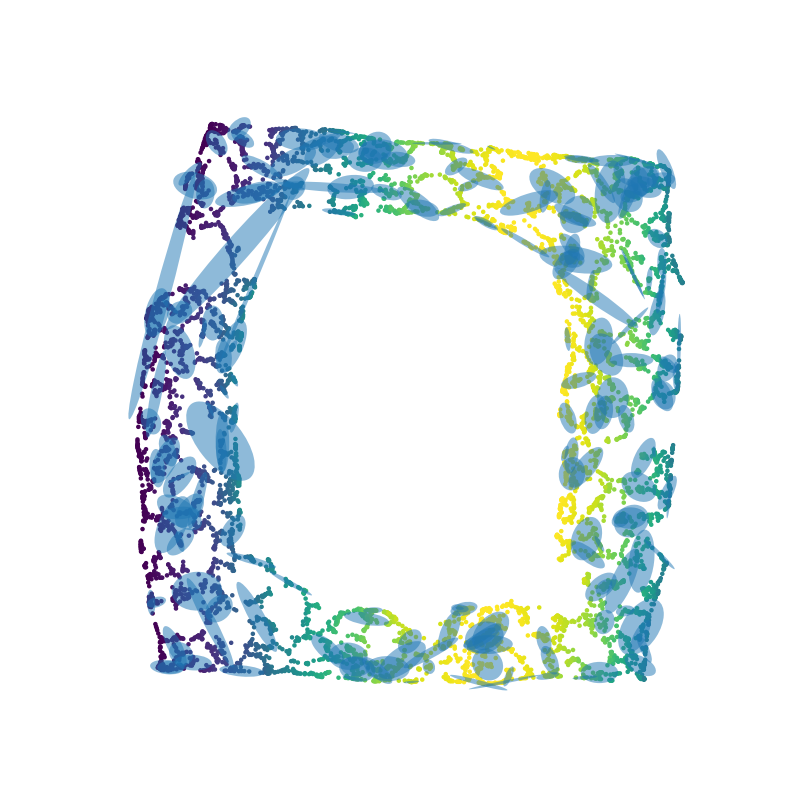

In [24]:
sr_umap.plot_result(200,10,2014012168,point_color=direction,point_size=dot_size)

In [90]:
sr_isomap.save_figure('png',600)
sr_LE.save_figure('png',600)
sr_LTSA.save_figure('png',600)
sr_LLE.save_figure('png',600)
sr_tsne.save_figure('png',600)
sr_umap.save_figure('png',600)


In [91]:

sr_isomap.save_figure('svg',3000)
sr_LE.save_figure('svg',3000)
sr_LTSA.save_figure('svg',3000)
sr_LLE.save_figure('svg',3000)
sr_tsne.save_figure('svg',3000)
sr_umap.save_figure('svg',3000)

# Chopped torus
R=4, r=1.5, only retain z >= -0.5 r

Chop below the z=0 sample size = 10000

In [6]:
# generate a chopped torus and 3d figure of it
R = 4
r= 1.5
chop_value = -0.5

def get_torus_data(n,chop_value,R,r): # chopvalue = propotion of r
    theta = 2*np.pi*(np.random.uniform(size=2*n))
    phi = 2*np.pi*(np.random.uniform(size=2*n))
    x = (R + r*np.sin(phi))*np.cos(theta)
    y = (R + r*np.sin(phi))*np.sin(theta)
    z = r*np.cos(phi)
    w = np.random.uniform(size=2*n)
    data = np.vstack((x,y,z)).T
    filter_array = np.array(
        [(data[i,2] >= chop_value* r) and ((R+r)*w[i]<=(R + r*np.sin(phi[i]))) for i in range(2*n)]
    )                                    
    data = data[filter_array]
    x = x[filter_array]
    y = y[filter_array]
    z = z[filter_array]
    return data, x , y ,z

xx,yy = np.meshgrid(np.arange(-8,8,0.5),np.arange(-8,8,0.5))
z = 0.0 * xx + 0.0 * yy-0.75

import pickle
data, x , y, z = get_torus_data(15000,chop_value, R,r)
pickle.dump(data, open('inward_ct.pickle','wb'))
# #data = pickle.load(open('inward_ct.pickle','rb'))
# fig, ax = plt.subplots(subplot_kw={"projection": "3d"},figsize=(20,15))
# #ax.plot_surface(X,Y,Z,antialiased=False, color='lightgray',alpha=1)
# #ax.plot_surface(xx,yy,z,alpha=0.5)
# ax.scatter(data[:,0], data[:,1], data[:,2],s=1,color='blue')
# ax.set_axis_off()
# ax.grid(False)
# ax.view_init(5,0)
# fig.tight_layout()
# fig.savefig('chopped_torus.svg')
# fig.savefig('chopped_torus.png',dpi=600)
# plt.show()

# remove the grid
# more data point 
# produce figures from another angle
# no axis; axis tight; axis equal unless something special
# put the figures in svg: have the individual figures / be careful of crops? 
# in algorithm section 4, no metric

# define the direction of plotting:


In [7]:
import pickle
#pickle.dump(data, open('inward_ct.pickle','wb'))
data = pickle.load(open('inward_ct.pickle','rb'))
data.shape

(14541, 3)

In [8]:
ct_isomap =  PlotResult(embedding_method='Isomap',data=data,dataname='inward_ct_',dimension=2,radius=0.25,output_dir=output_dir)
ct_isomap.compute_geom()

In [9]:
# think of other eigenvectors
ct_le =  PlotResult(embedding_method='LE',data=data,dataname='inward_ct_',dimension=2,radius=0.25,output_dir=output_dir)
ct_le.compute_geom()

In [10]:
ct_lle =  PlotResult(embedding_method='LLE',data=data,dataname='inward_ct_',dimension=2,radius=0.25,output_dir=output_dir)
ct_lle.compute_geom()

In [11]:
ct_ltsa =  PlotResult(embedding_method='LTSA',data=data,dataname='inward_ct_',dimension=2,radius=0.3,output_dir=output_dir)
ct_ltsa.compute_geom()


In [12]:
ct_tsne = PlotResult(embedding_method = 't-SNE',data=data,dataname='inward_ct_',dimension=2,radius=0.25,output_dir=output_dir)
ct_tsne.compute_geom()

In [13]:
ct_umap = PlotResult(embedding_method = 'Umap',data=data,dataname='inward_ct_',dimension=2,radius=0.5,output_dir=output_dir)
ct_umap.compute_geom()

In [14]:
direction=y if name=="_horiz" else z

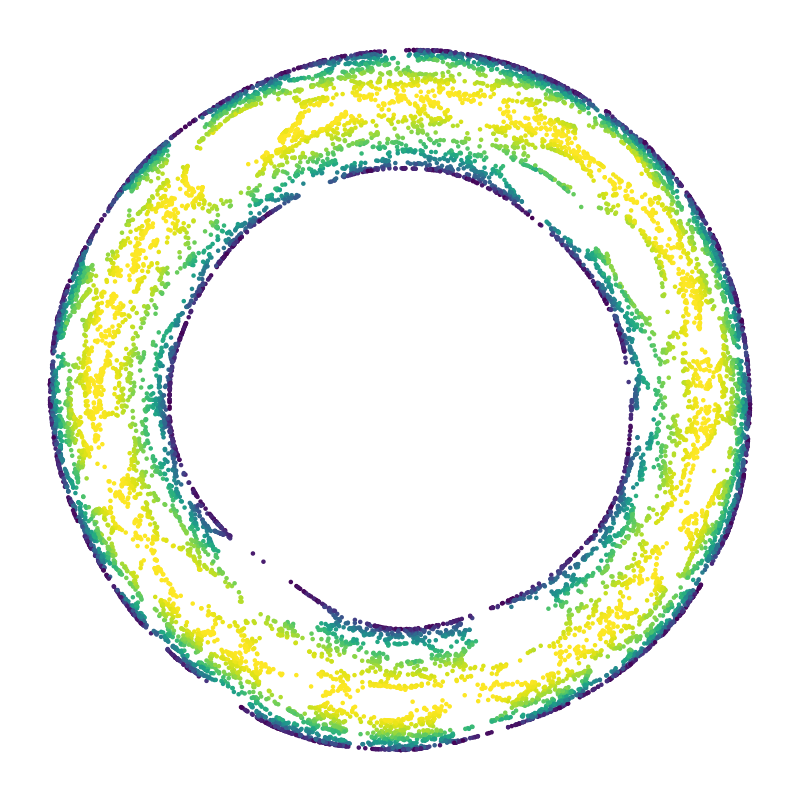

In [9]:
ct_le.interactive_plot(0.3,point_color=direction,point_size=dot_size)

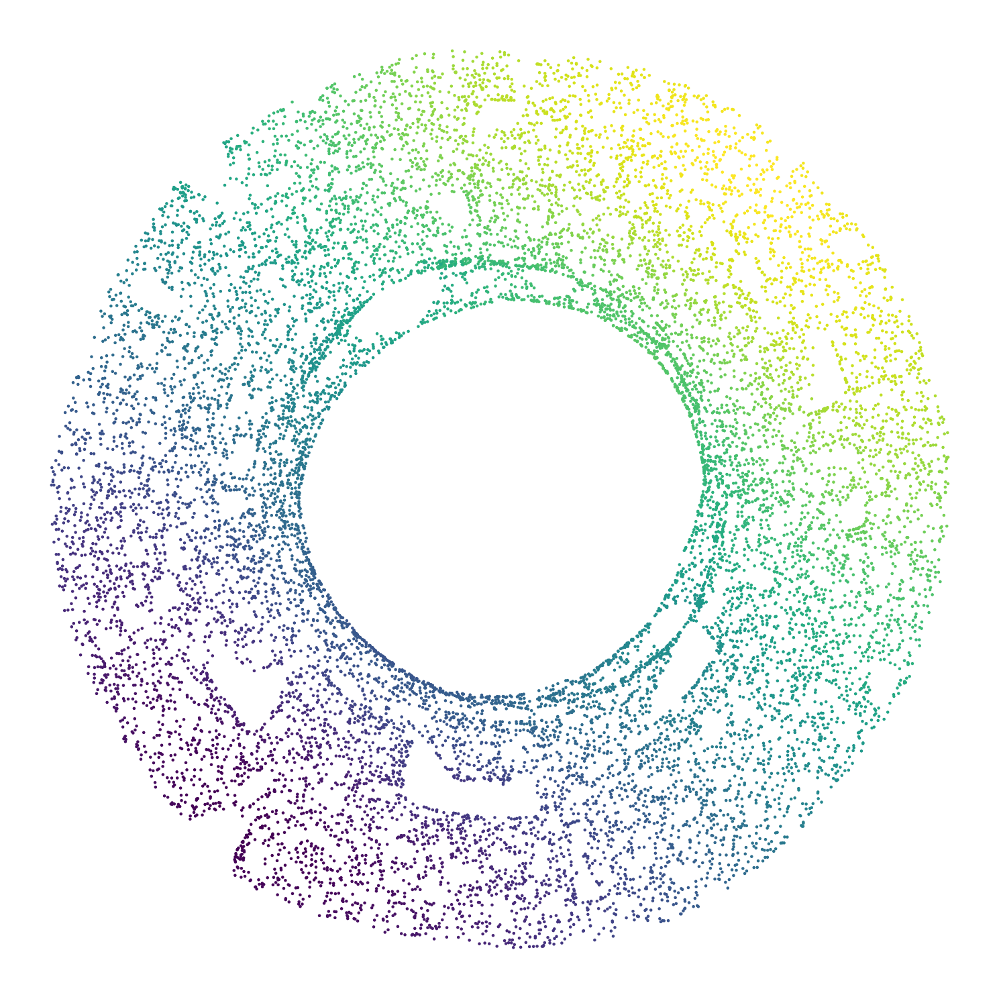

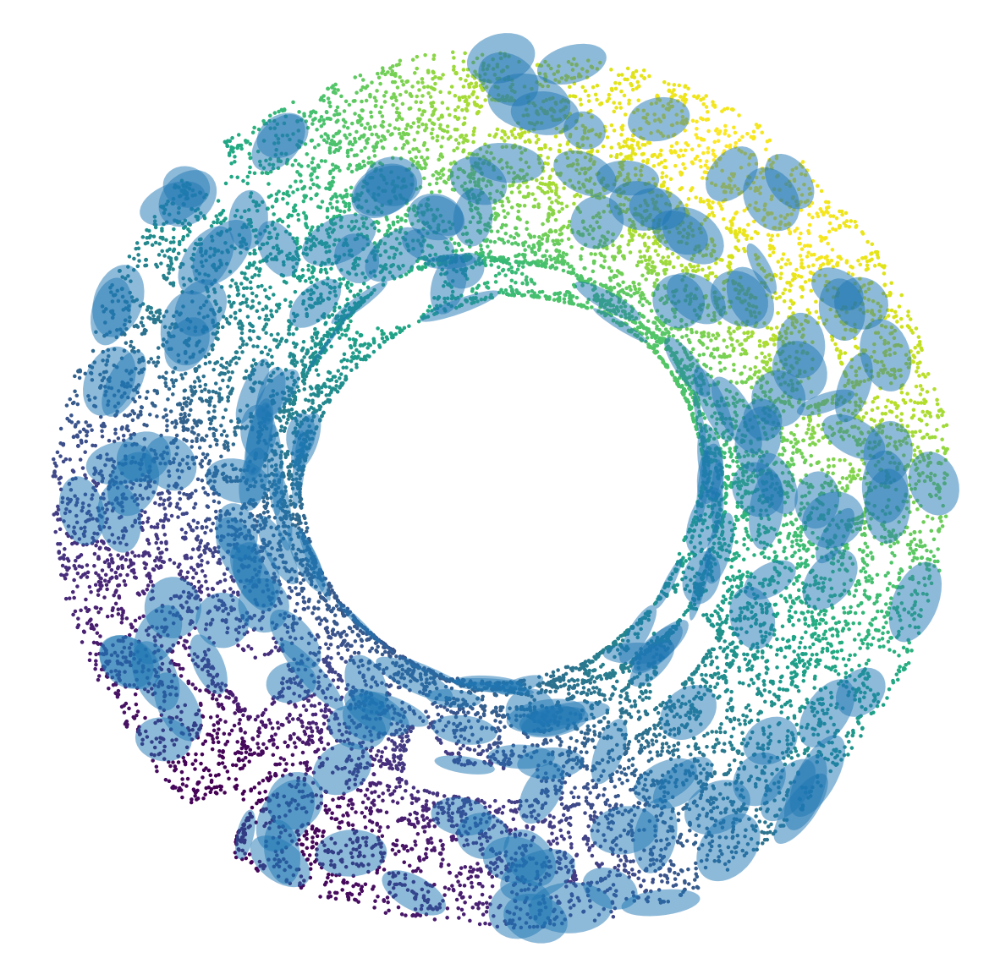

In [ ]:
ct_isomap.plot_result(200,0.15,2014012168,point_color=direction,point_size=dot_size)


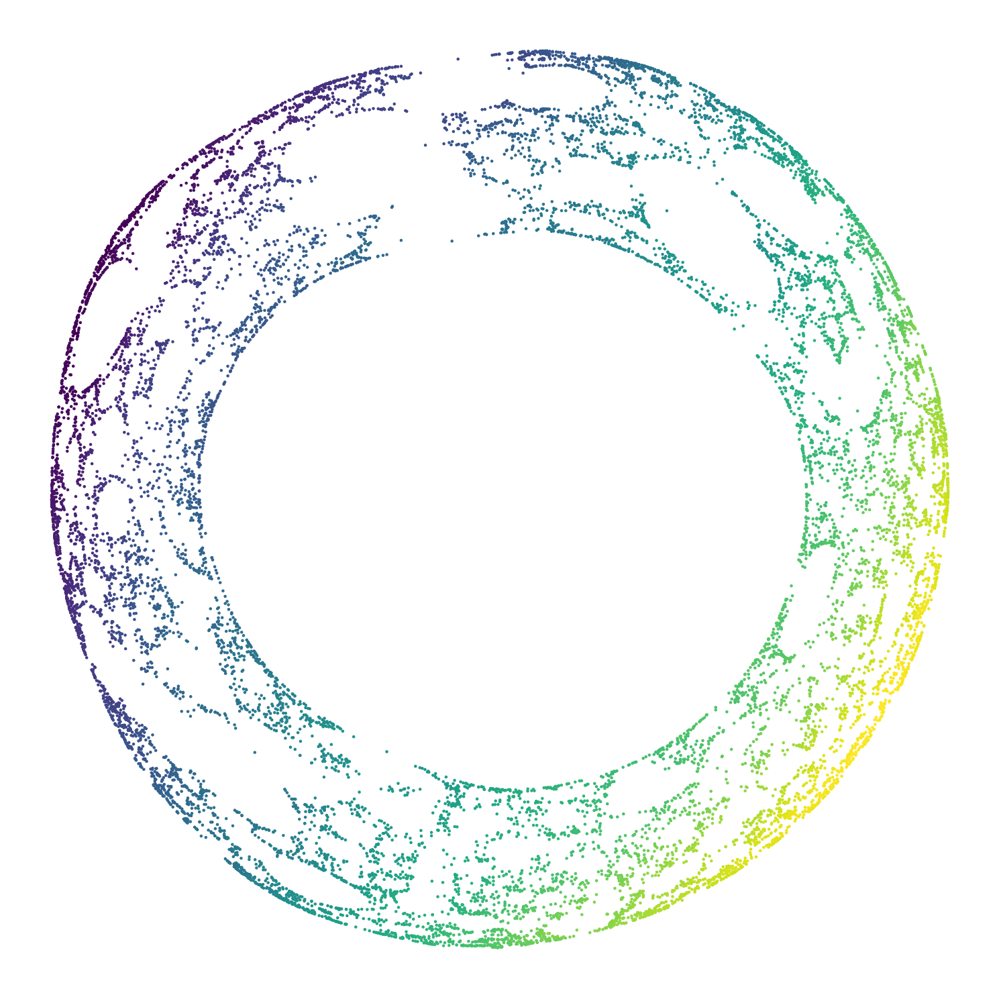

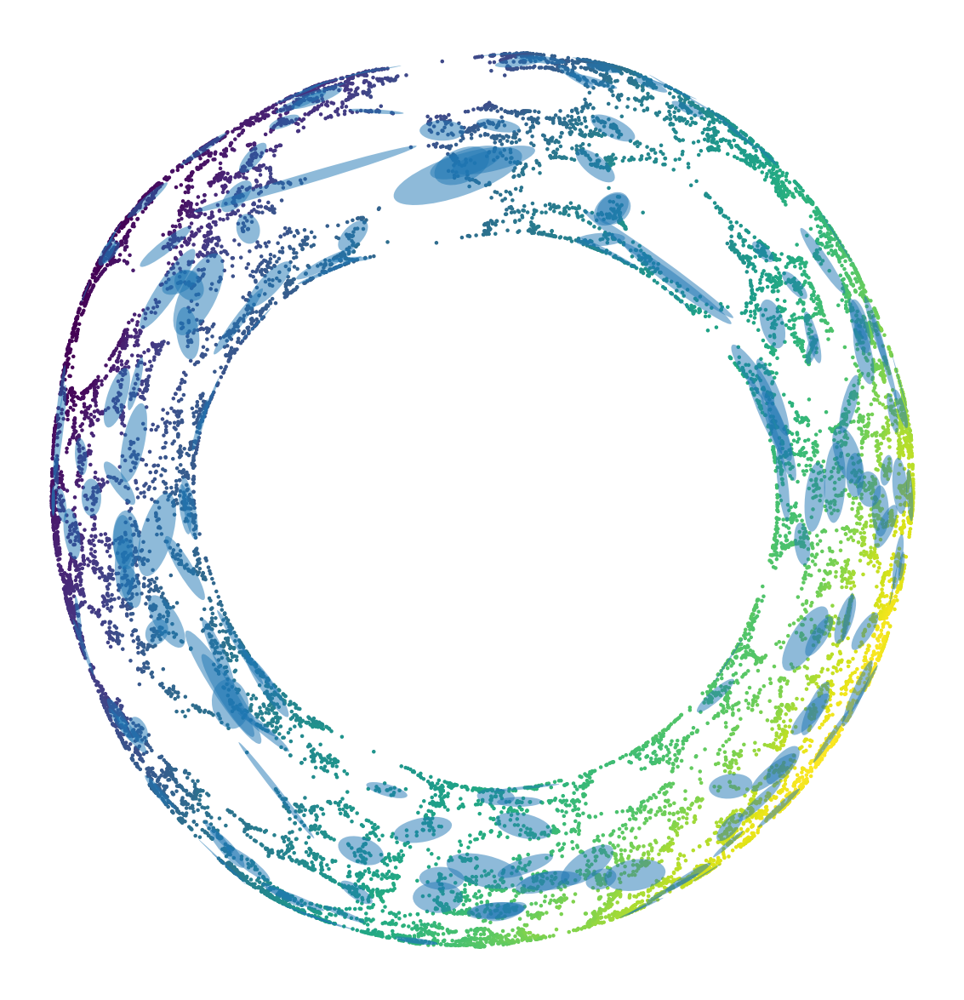

In [ ]:
ct_le.plot_result(200,0.1,2014012168,point_color=direction,point_size=dot_size)


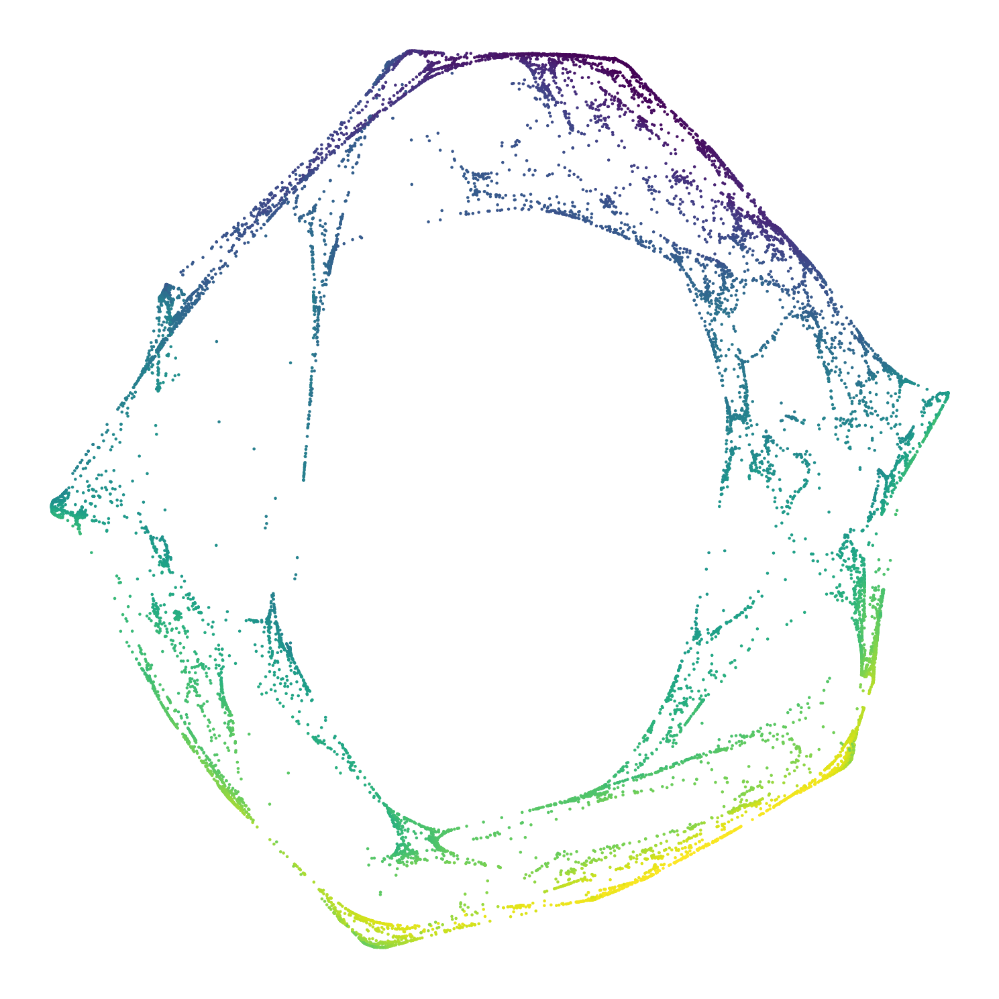

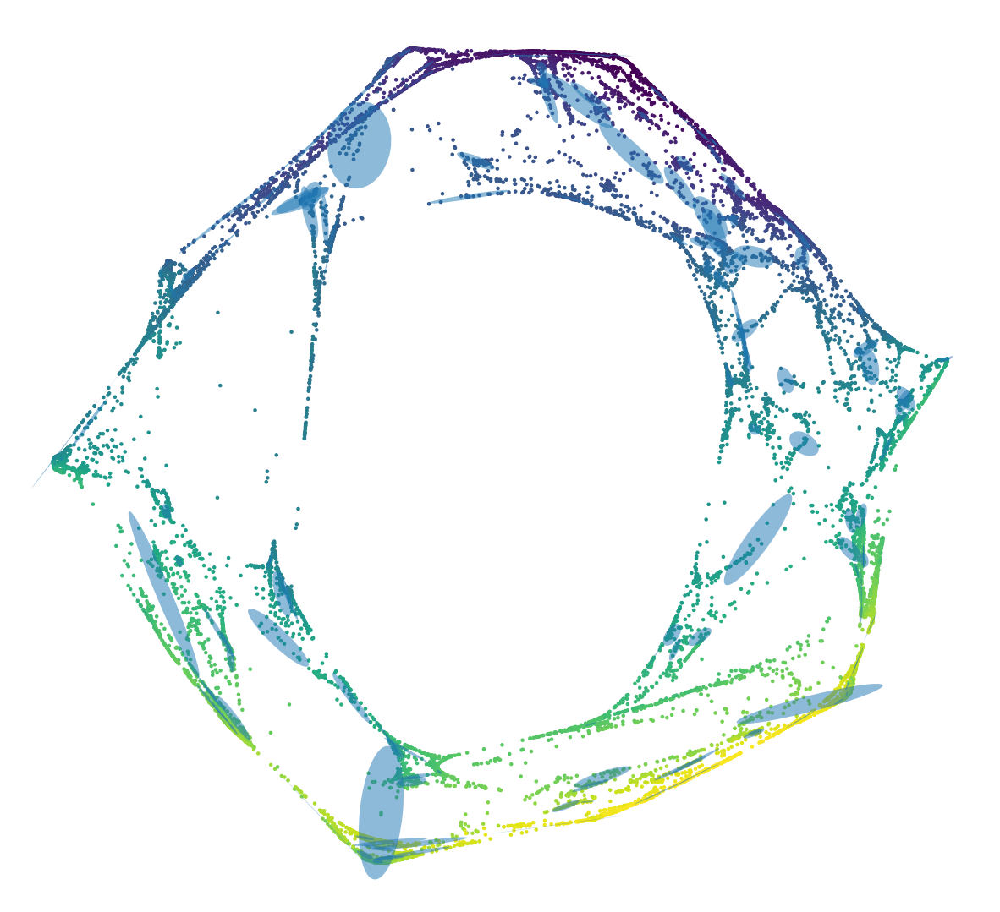

In [ ]:
ct_lle.plot_result(200,0.05,2014012168,point_color=direction,point_size=dot_size)

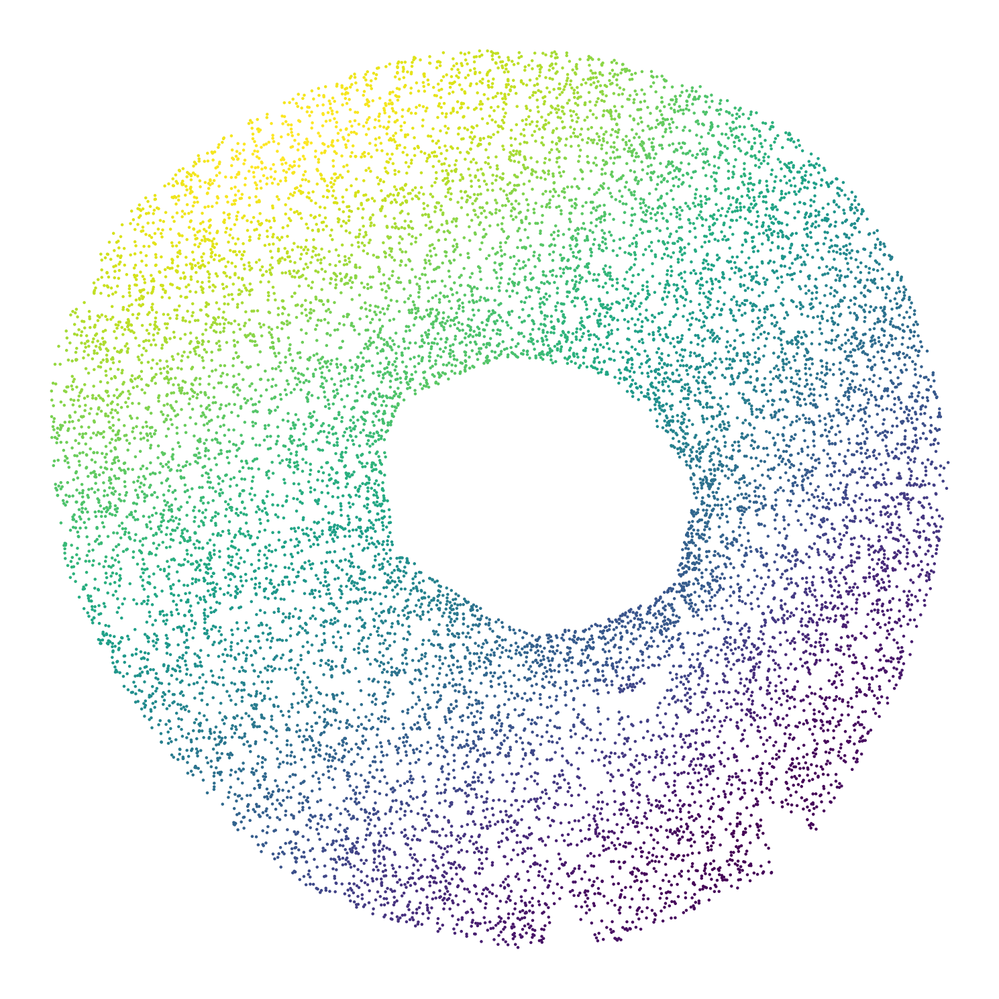

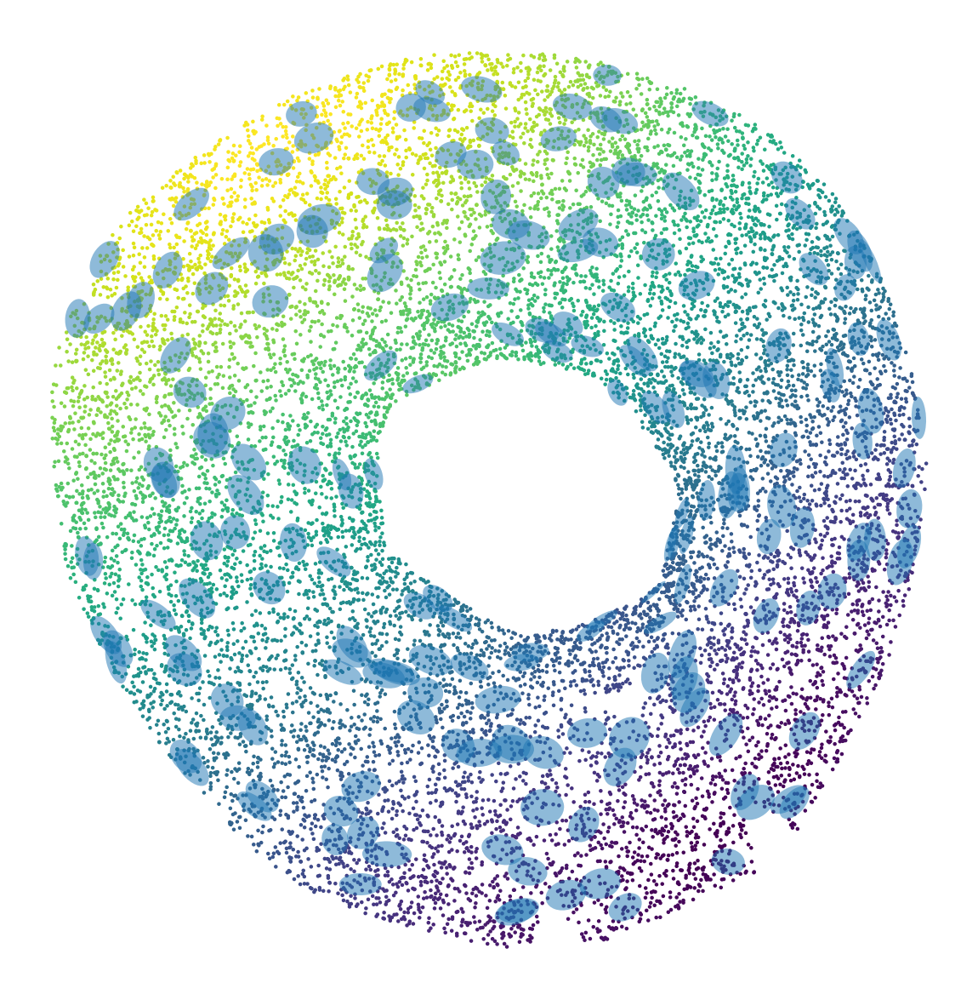

In [ ]:
ct_ltsa.plot_result(200,0.05,2014012168,point_color=direction,point_size=dot_size)

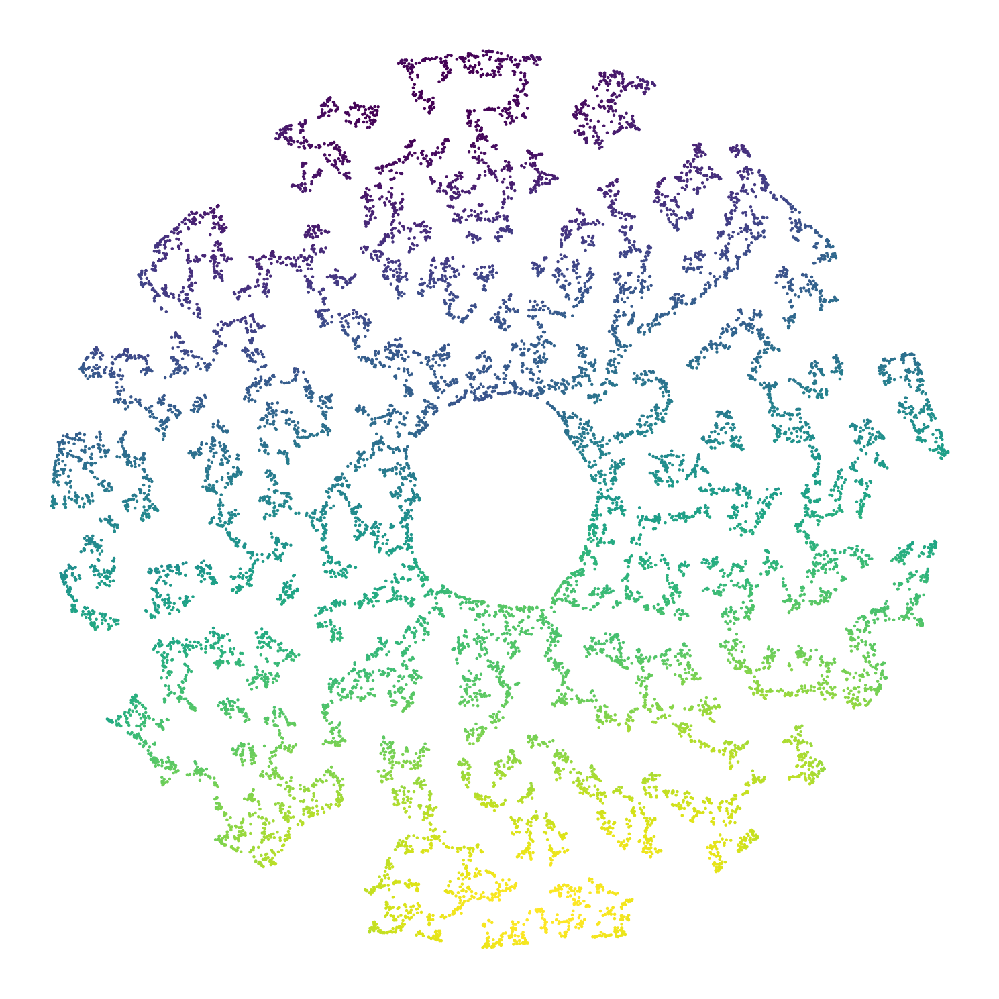

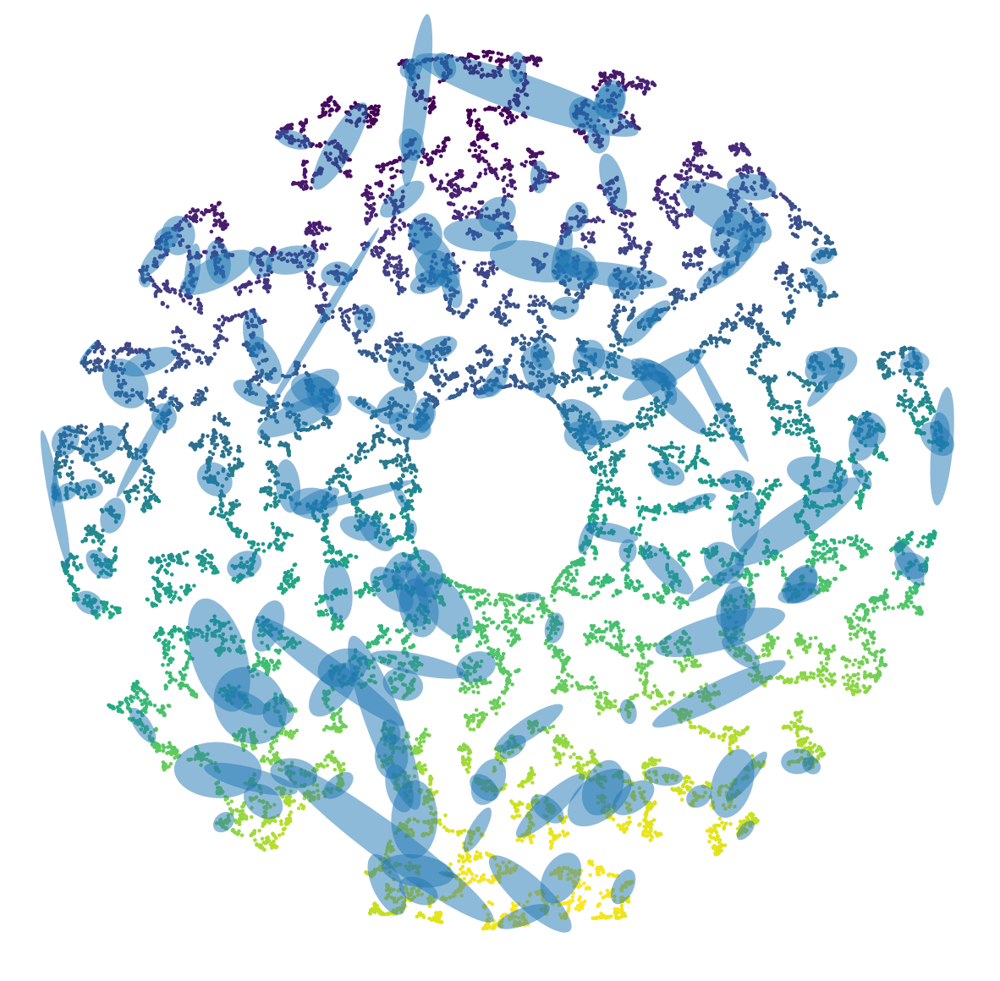

In [ ]:
ct_tsne.plot_result(200,0.1,2014012168,point_color=direction,point_size=dot_size)

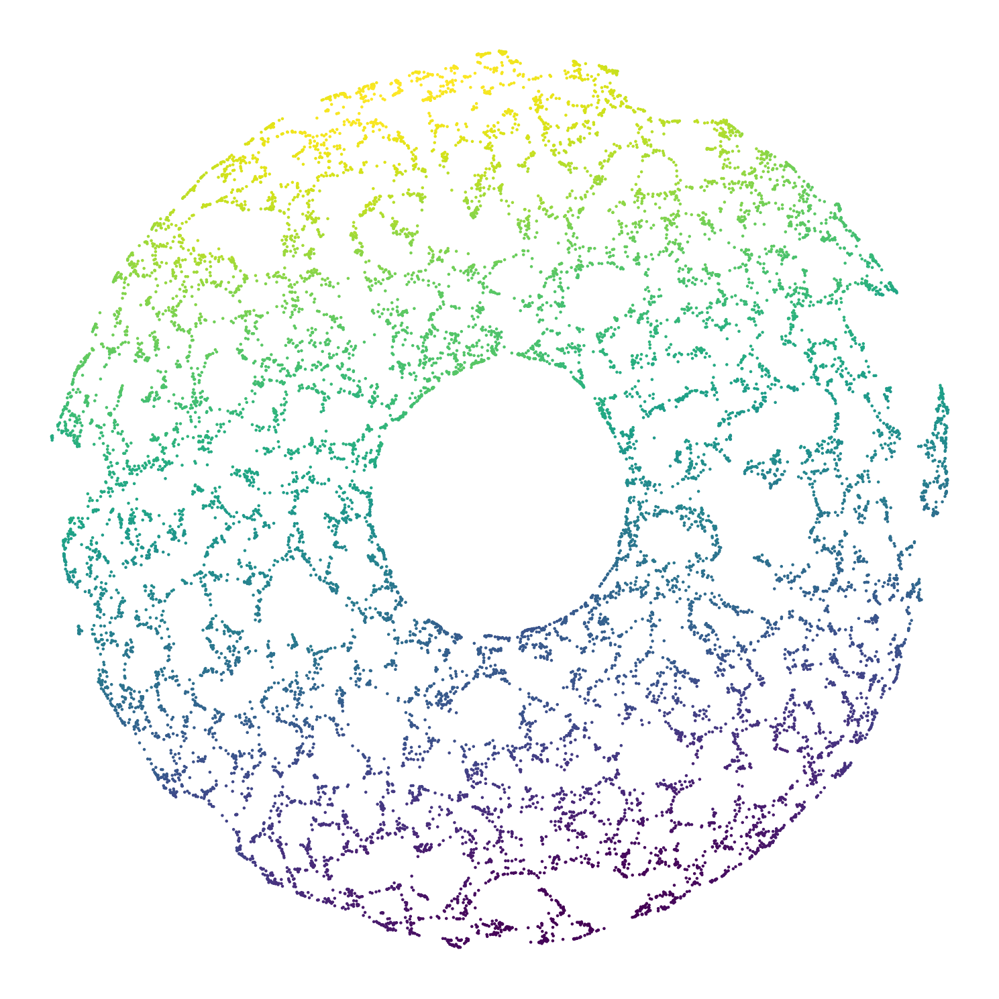

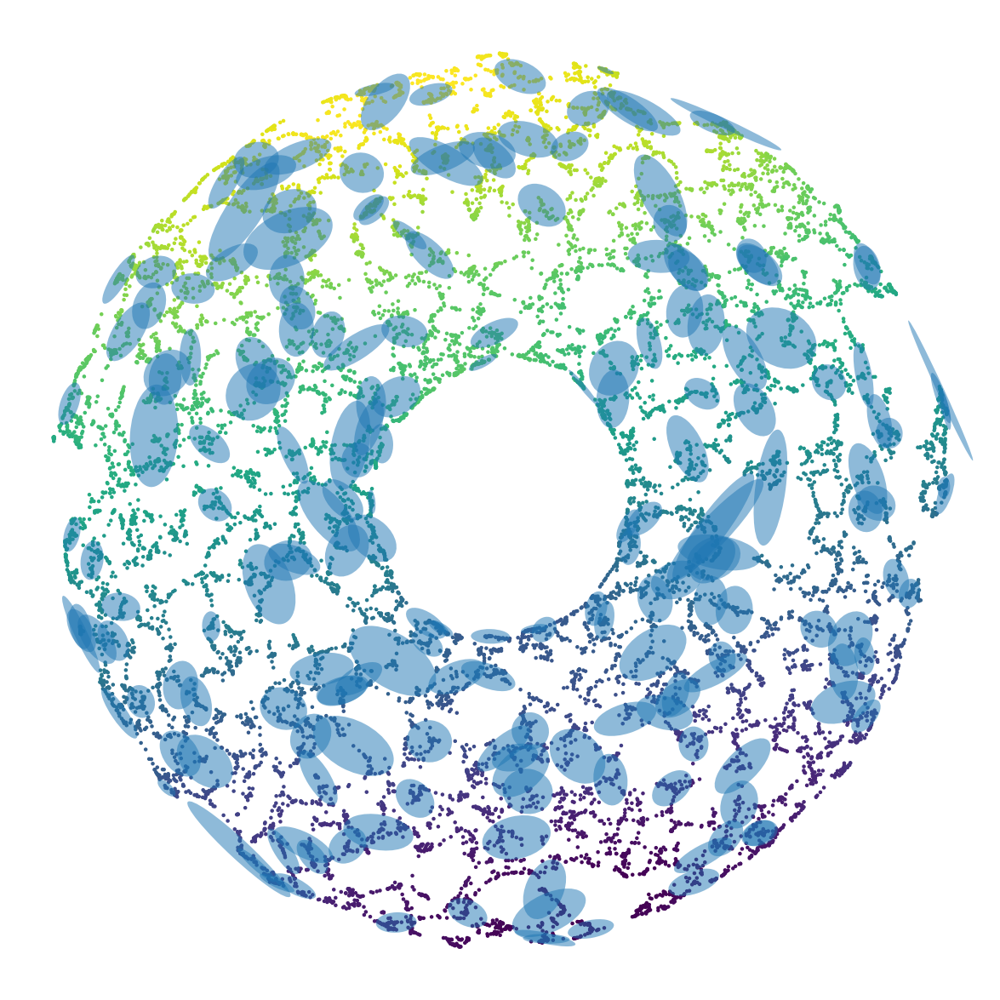

In [ ]:
ct_umap.plot_result(200,0.1,2014012168,point_color=direction,point_size=dot_size)

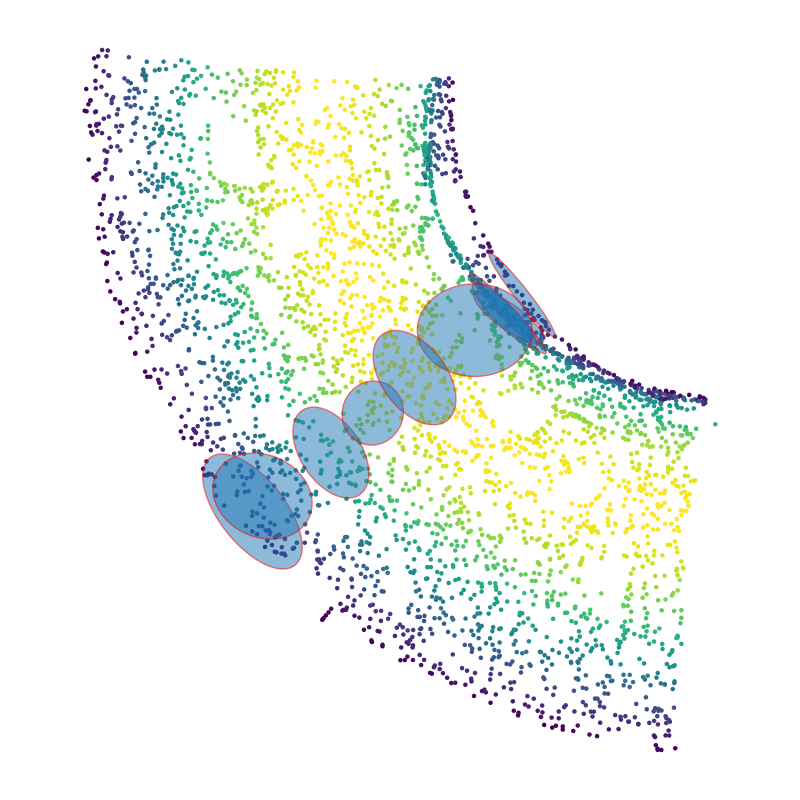

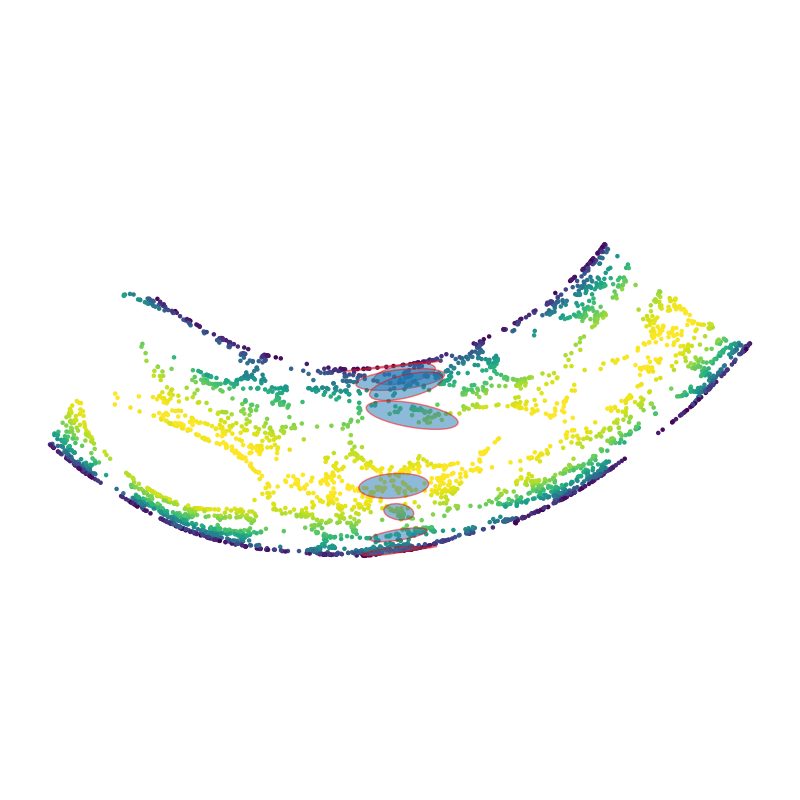

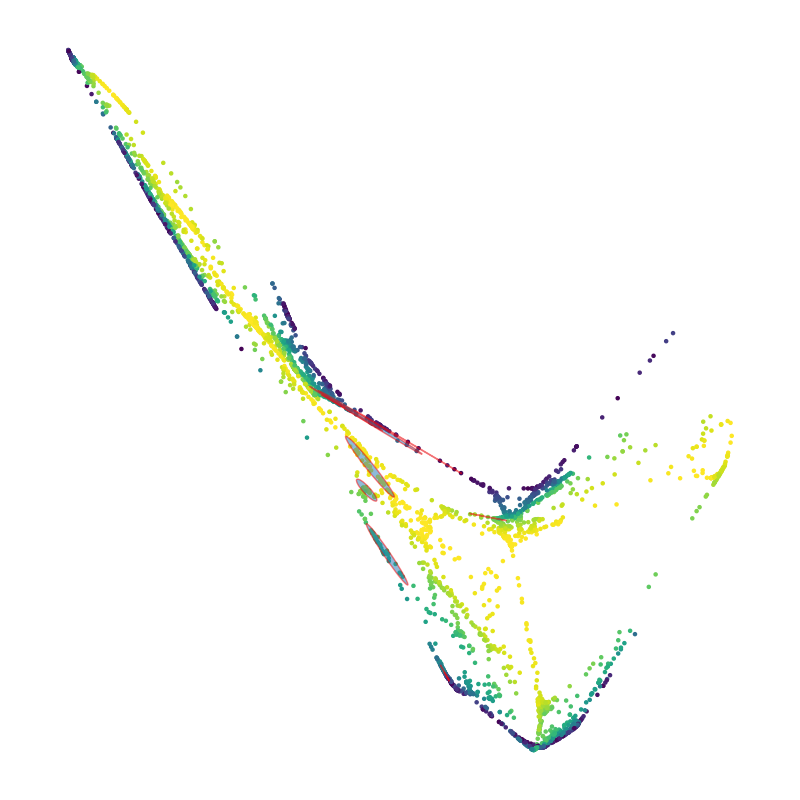

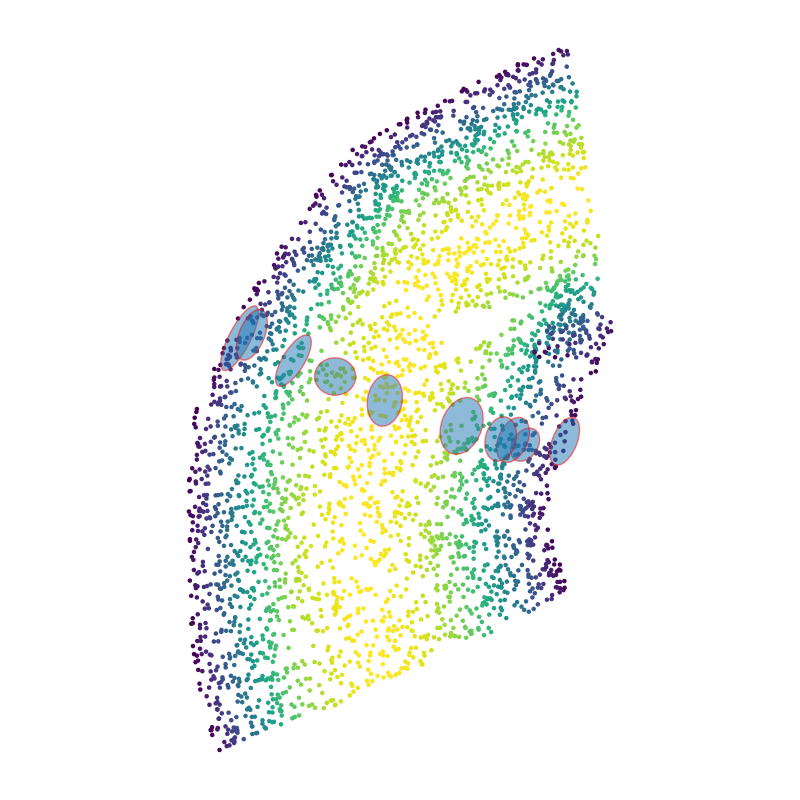

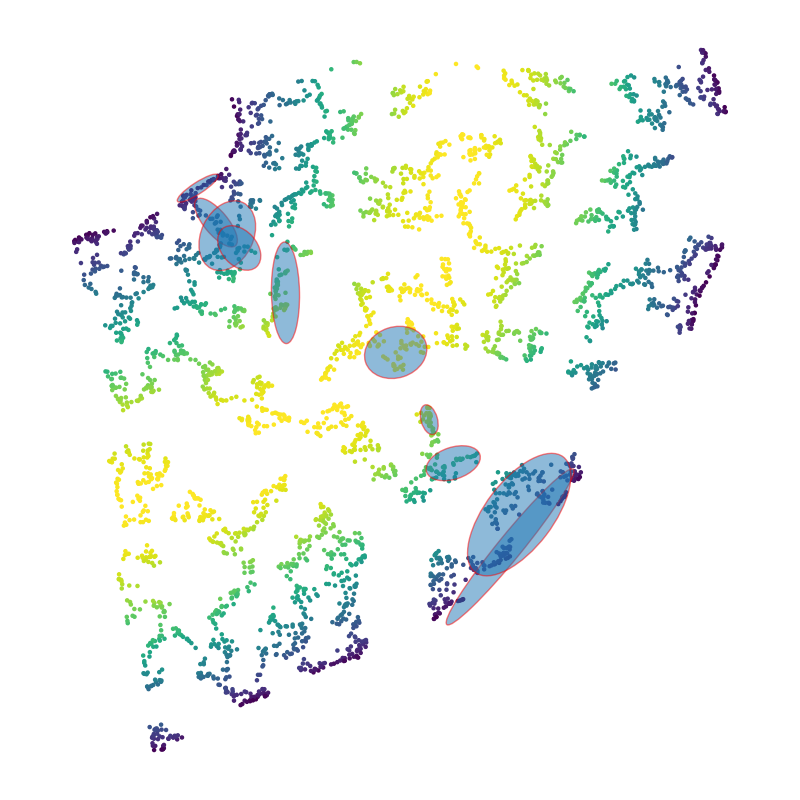

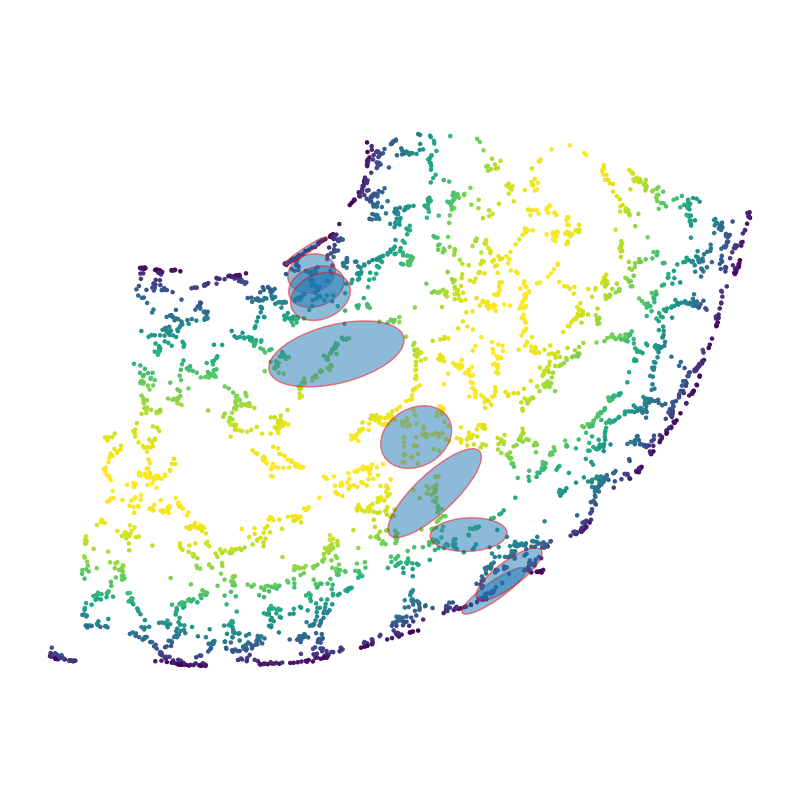

In [17]:
indices = np.where(( 0<= y) & (y <=0.1) & (x>0))[0]
cropped_index, closest_indices = helper_plot_radius(x, y, z, indices, cut_degree=45)
ct_isomap.plot_radius(cropped_index,closest_indices,0.15,point_color=direction[cropped_index],point_size=dot_size)
ct_le.plot_radius(cropped_index,closest_indices,0.1,point_color=direction[cropped_index],point_size=dot_size)
ct_lle.plot_radius(cropped_index,closest_indices,0.05,point_color=direction[cropped_index],point_size=dot_size)
ct_ltsa.plot_radius(cropped_index,closest_indices,0.05,point_color=direction[cropped_index],point_size=dot_size)
ct_tsne.plot_radius(cropped_index,closest_indices,0.1,point_color=direction[cropped_index],point_size=dot_size)
ct_umap.plot_radius(cropped_index,closest_indices,0.1,point_color=direction[cropped_index],point_size=dot_size)

In [50]:
ct_isomap.save_figure('png',600)
ct_le.save_figure('png',600)
ct_lle.save_figure('png',600)
ct_ltsa.save_figure('png',600)
ct_tsne.save_figure('png',600)
ct_umap.save_figure('png',600)

In [51]:
ct_isomap.save_figure('svg',3000)
ct_le.save_figure('svg',3000)
ct_lle.save_figure('svg',3000)
ct_ltsa.save_figure('svg',3000)
ct_tsne.save_figure('svg',3000)
ct_umap.save_figure('svg',3000)

# MNIST
run 2 t-snes on MNIST and show instability of embedding.
show 

In [ ]:
from sklearn.datasets import load_digits

digits = load_digits(n_class=6)
X, y = digits.data, digits.target
n_samples, n_features = X.shape
n_neighbors = 30

In [24]:
# helper function to plot embedding
from matplotlib import offsetbox
from sklearn.preprocessing import MinMaxScaler
def plot_embedding(X, title):
    _, ax = plt.subplots()
    X = MinMaxScaler().fit_transform(X)

    for digit in digits.target_names:
        ax.scatter(
            *X[y == digit].T,
            marker=f"${digit}$",
            s=60,
            color=plt.cm.Dark2(digit),
            alpha=0.425,
            zorder=2,
        )
    shown_images = np.array([[1.0, 1.0]])  # just something big
    for i in range(X.shape[0]):
        # plot every digit on the embedding
        # show an annotation box for a group of digits
        dist = np.sum((X[i] - shown_images) ** 2, 1)
        if np.min(dist) < 4e-3:
            # don't show points that are too close
            continue
        shown_images = np.concatenate([shown_images, [X[i]]], axis=0)
        imagebox = offsetbox.AnnotationBbox(
            offsetbox.OffsetImage(digits.images[i], cmap=plt.cm.gray_r), X[i]
        )
        imagebox.set(zorder=1)
        ax.add_artist(imagebox)

    ax.set_title(title)
    ax.axis("off")
    print("any")
    plt.savefig(output_dir+title.replace(' ','_'))

# change the digits markers to be just small points
# make one without images / one image per cluster
# digits; galaxy; molecules

In [25]:
mnist_isomap =  PlotResult(embedding_method='Isomap',data=X,dataname='mnist_',dimension=2,radius=50,output_dir=output_dir)
mnist_isomap.compute_geom()

any


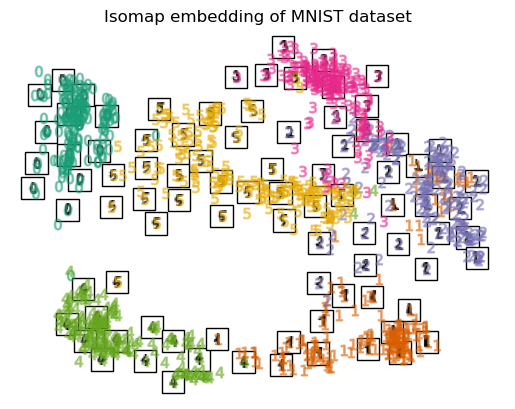

In [26]:
embedded_mnist = mnist_isomap.embedded_data
plot_embedding(embedded_mnist, 'Isomap embedding of MNIST dataset')

any


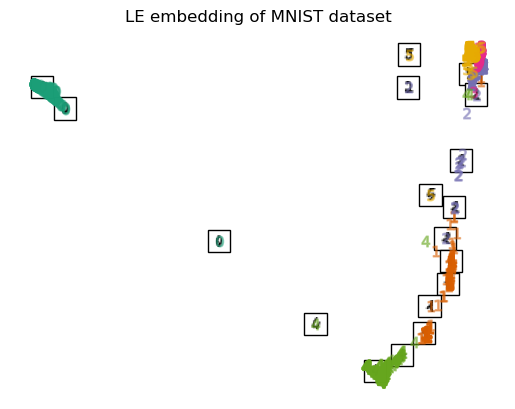

In [27]:
# other eigenvector
mnist_le =  PlotResult(embedding_method='LE',data=X,dataname='mnist_',dimension=2,radius=50,output_dir=output_dir)
mnist_le.compute_geom()
embedded_mnist = mnist_le.embedded_data
plot_embedding(embedded_mnist, 'LE embedding of MNIST dataset')

any


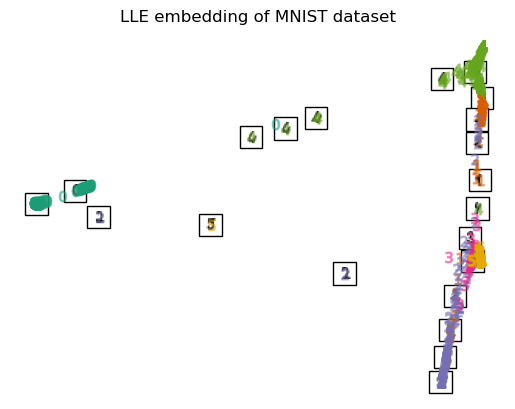

In [28]:
mnist_lle =  PlotResult(embedding_method='LLE',data=X,dataname='mnist_',dimension=2,radius=50,output_dir=output_dir)
mnist_lle.compute_geom()
embedded_mnist = mnist_lle.embedded_data
plot_embedding(embedded_mnist, 'LLE embedding of MNIST dataset')

any


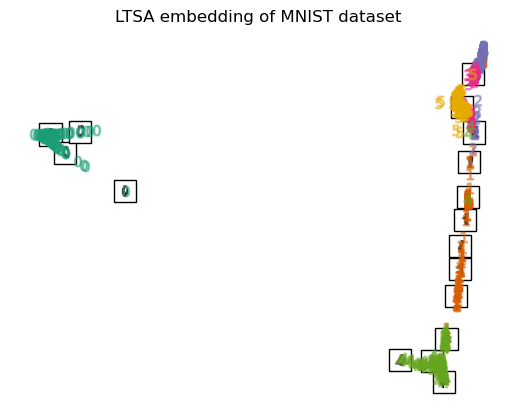

In [29]:
mnist_ltsa =  PlotResult(embedding_method='LTSA',data=X,dataname='mnist_',dimension=2,radius=50,output_dir=output_dir)
mnist_ltsa.compute_geom()
embedded_mnist = mnist_ltsa.embedded_data
plot_embedding(embedded_mnist, 'LTSA embedding of MNIST dataset')

any


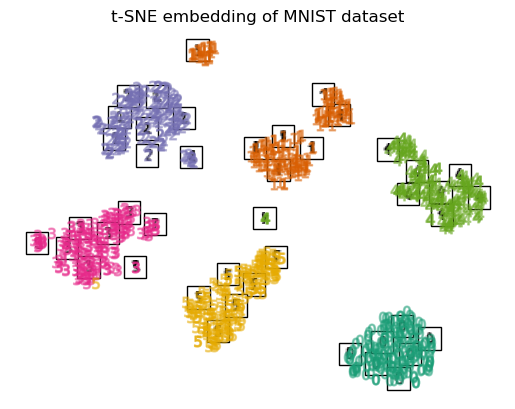

In [30]:
mnist_tsne =  PlotResult(embedding_method='t-SNE',data=X,dataname='mnist_',dimension=2,radius=50,output_dir=output_dir)
mnist_tsne.compute_geom()
embedded_mnist = mnist_tsne.embedded_data
plot_embedding(embedded_mnist, 't-SNE embedding of MNIST dataset')

any


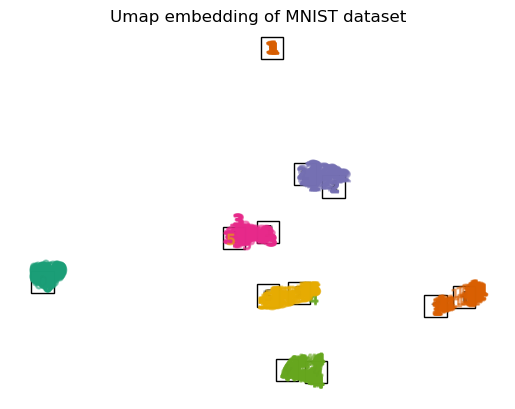

In [31]:
mnist_umap =  PlotResult(embedding_method='Umap',data=X,dataname='mnist_',dimension=2,radius=50,output_dir=output_dir)
mnist_umap.compute_geom()
embedded_mnist = mnist_umap.embedded_data
plot_embedding(embedded_mnist, 'Umap embedding of MNIST dataset')

# Embeddings of molecules